In [1]:
import pandas as pd
import numpy as np

import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import MinMaxScaler
from sklearn import linear_model
from sklearn import metrics

import statsmodels.api as sm
from statsmodels.tools import eval_measures

In [2]:
datareg = pd.read_csv("final.csv")

In [3]:
datareg.head(2)

,operation,property_type,place_name,place_with_parent_names,country_name,state_name,geonames_id,lat,lon,price,...,price_per_m2,floor,rooms,description,title,precios_sin_outliers,pileta,cochera,ambientes,barrio_cerrado
0,sell,PH,Mataderos,|Argentina|Capital Federal|Mataderos|,Argentina,Capital Federal,3430787.0,-34.661824,-58.508839,62000.0,...,1550.0,NaN,NaN,"2 AMBIENTES TIPO CASA PLANTA BAJA POR PASILLO,...",2 AMB TIPO CASA SIN EXPENSAS EN PB,1127.272727,0,0,2.0,NaN
1,sell,apartment,La Plata,|Argentina|Bs.As. G.B.A. Zona Sur|La Plata|,Argentina,Bs.As. G.B.A. Zona Sur,3432039.0,-34.903883,-57.964330,150000.0,...,NaN,NaN,NaN,Venta de departamento en décimo piso al frente...,VENTA Depto 2 dorm. a estrenar 7 e/ 36 y 37 ...,NaN,0,1,NaN,NaN


In [4]:
datareg=datareg.drop(columns=['operation','floor','surface_total_in_m2','title','description','barrio_cerrado','currency','rooms'])

In [5]:
datareg=datareg.drop(columns=['geonames_id', 'price', 'price_aprox_usd','price_usd_per_m2', 'price_per_m2','place_with_parent_names','country_name','place_name','ambientes','lat','lon'])

In [6]:
datareg.columns

Index(['property_type', 'state_name', 'surface_covered_in_m2',
       'precios_sin_outliers', 'pileta', 'cochera'],
      dtype='object')

In [7]:
(datareg.isnull().sum()/datareg.shape[0])*100

property_type             0.000000
state_name                0.000000
surface_covered_in_m2    15.452490
precios_sin_outliers     20.184596
pileta                    0.000000
cochera                   0.000000
dtype: float64

In [8]:
datareg=datareg.mask(datareg['pileta'].isnull(),0)

In [9]:
#datareg=datareg.mask(datareg['cochera'].isnull(),0)

In [10]:
(datareg.isnull().sum()/datareg.shape[0])*100

property_type             0.000000
state_name                0.000000
surface_covered_in_m2    15.452490
precios_sin_outliers     20.184596
pileta                    0.000000
cochera                   0.000000
dtype: float64

In [11]:
datareg.shape

(108345, 6)

In [12]:
mascara=-datareg['precios_sin_outliers'].isnull()
mascara

0          True
1         False
2          True
3         False
4          True
          ...  
108340    False
108341     True
108342     True
108343     True
108344     True
Name: precios_sin_outliers, Length: 108345, dtype: bool

In [13]:
datareg=datareg[mascara]

In [14]:
datareg=datareg.dropna()

In [15]:
datareg.shape

(81699, 6)

In [16]:
(datareg.isnull().sum()/datareg.shape[0])*100


property_type            0.0
state_name               0.0
surface_covered_in_m2    0.0
precios_sin_outliers     0.0
pileta                   0.0
cochera                  0.0
dtype: float64

Miremos las variables categoricas para utilizar one hot encoder.

In [17]:
datareg.dtypes

property_type             object
state_name                object
surface_covered_in_m2    float64
precios_sin_outliers     float64
pileta                     int64
cochera                    int64
dtype: object

In [18]:
datareg=datareg.astype({'property_type': 'str'})

In [19]:
datareg=datareg.astype({'state_name': 'str'})

In [20]:
from matplotlib import pyplot as plt

In [21]:
datareg

,property_type,state_name,surface_covered_in_m2,precios_sin_outliers,pileta,cochera
0,PH,Capital Federal,40.0,1127.272727,0,0
2,apartment,Capital Federal,55.0,1309.090909,0,0
4,apartment,Buenos Aires Costa Atlántica,35.0,1828.571429,0,0
6,PH,Bs.As. G.B.A. Zona Norte,78.0,1226.415094,0,0
7,apartment,Capital Federal,40.0,3066.666667,1,0
...,...,...,...,...,...,...
108293,apartment,Capital Federal,39.0,3750.000000,0,0
108341,apartment,Capital Federal,93.0,9354.838710,1,1
108342,house,Bs.As. G.B.A. Zona Norte,360.0,1383.333333,1,1
108343,apartment,Capital Federal,39.0,2858.695652,0,1


In [22]:
def cleanOutliers(column):
    ## Definimos los umbrales de comparación
    q3=column.quantile(0.75)
    q1=column.quantile(0.25)
    rango_intercuartil=q3-q1
    limite_superior= q3+rango_intercuartil*1.5
    limite_inferior = q1-rango_intercuartil*1.5
    
    ## Imputamos nulos en los valores outliers
    mask_outlier = (column<limite_inferior) | (column>limite_superior) 
    column[mask_outlier] = np.NaN

    return column

In [23]:
datareg['precios_sin_outliers']=cleanOutliers(datareg['precios_sin_outliers'])
datareg['surface_covered_in_m2']=cleanOutliers(datareg['surface_covered_in_m2'])

<ipython-input-22-6e21b8949282>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[mask_outlier] = np.NaN
<ipython-input-22-6e21b8949282>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  column[mask_outlier] = np.NaN


apartment    47570
house        27297
PH            4398
store         2434
Name: property_type, dtype: int64


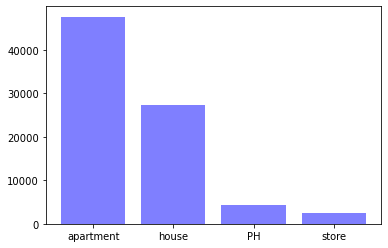

Capital Federal                 25564
Bs.As. G.B.A. Zona Norte        20871
Bs.As. G.B.A. Zona Sur           9181
Buenos Aires Costa Atlántica     6582
Córdoba                          6149
Bs.As. G.B.A. Zona Oeste         5783
Santa Fe                         4241
Buenos Aires Interior            1388
Corrientes                        373
Mendoza                           371
Neuquén                           226
Misiones                          207
Río Negro                         205
San Luis                          143
Entre Ríos                         95
Tucumán                            78
Salta                              76
Chubut                             49
Chaco                              28
Tierra Del Fuego                   26
La Pampa                           19
Catamarca                          16
Jujuy                              10
Santa Cruz                          9
San Juan                            4
Santiago Del Estero                 3
La Rioja    

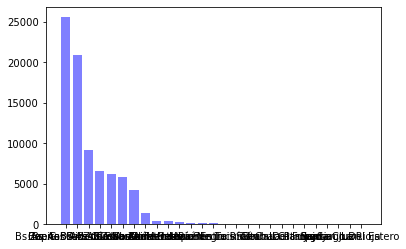

40.0     2201
50.0     1740
45.0     1697
60.0     1604
100.0    1483
         ... 
9.0         4
5.0         4
11.0        3
13.0        3
0.0         2
Name: surface_covered_in_m2, Length: 308, dtype: int64


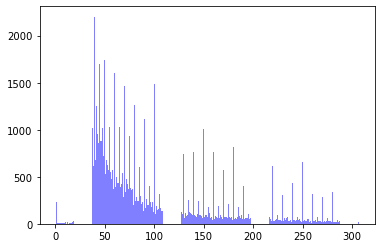

0    58352
1    23347
Name: pileta, dtype: int64


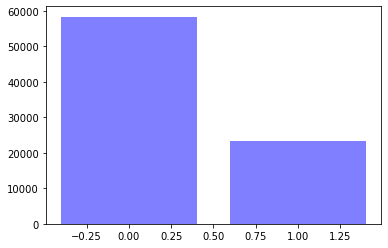

0    46765
1    34934
Name: cochera, dtype: int64


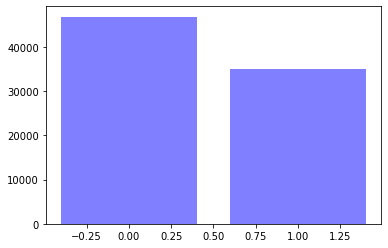

In [24]:
# Aplicar value_counts() a

categories = ['property_type', 'state_name', 'surface_covered_in_m2','pileta','cochera']

for category in categories:
    print(datareg[category].value_counts())
    plt.bar(datareg[category].value_counts().index, datareg[category].value_counts().values, color='b',\
            alpha=0.5)
    plt.show()

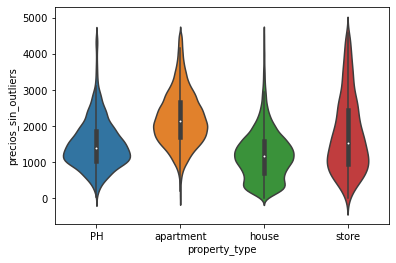

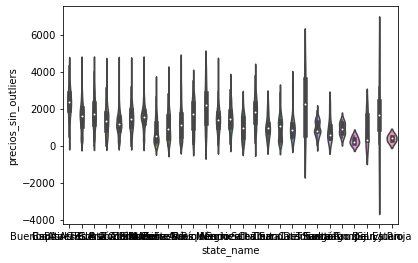

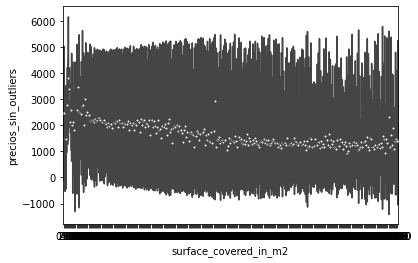

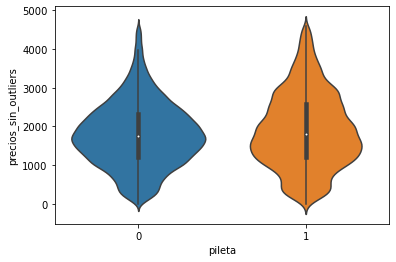

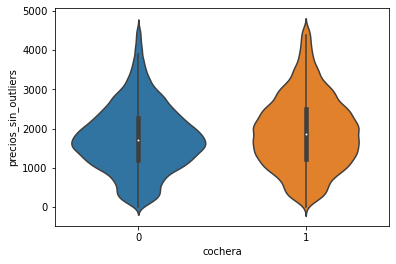

In [25]:
# Hacer unos violinplots a las series 'property_type', 'state_name', 'surface_covered_in_m2','pileta','cochera'

for category in categories:
    sns.violinplot(x=category, y='precios_sin_outliers', data=datareg)
    plt.show()



In [26]:
datareg.columns

Index(['property_type', 'state_name', 'surface_covered_in_m2',
       'precios_sin_outliers', 'pileta', 'cochera'],
      dtype='object')

In [27]:
categoricals = ['property_type','state_name']

enc = OneHotEncoder(drop='first')
X = datareg[categoricals]
enc.fit(X)
enc.categories_

[array(['PH', 'apartment', 'house', 'store'], dtype=object),
 array(['Bs.As. G.B.A. Zona Norte', 'Bs.As. G.B.A. Zona Oeste',
        'Bs.As. G.B.A. Zona Sur', 'Buenos Aires Costa Atlántica',
        'Buenos Aires Interior', 'Capital Federal', 'Catamarca', 'Chaco',
        'Chubut', 'Corrientes', 'Córdoba', 'Entre Ríos', 'Jujuy',
        'La Pampa', 'La Rioja', 'Mendoza', 'Misiones', 'Neuquén',
        'Río Negro', 'Salta', 'San Juan', 'San Luis', 'Santa Cruz',
        'Santa Fe', 'Santiago Del Estero', 'Tierra Del Fuego', 'Tucumán'],
       dtype=object)]

In [28]:
dummies = enc.transform(X).toarray()
dummies

array([[0., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 1., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.]])

In [29]:
dummies.shape

(81699, 29)

In [30]:
dummies_df = pd.DataFrame(dummies)
dummies_df

,0,1,2,3,4,5,6,7,8,9,...,19,20,21,22,23,24,25,26,27,28
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81694,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
81695,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
81696,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
81697,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [31]:
col_names = [categoricals[i] + '_' + enc.categories_[i] for i in range(len(categoricals)) ]

col_names

[array(['property_type_PH', 'property_type_apartment',
        'property_type_house', 'property_type_store'], dtype=object),
 array(['state_name_Bs.As. G.B.A. Zona Norte',
        'state_name_Bs.As. G.B.A. Zona Oeste',
        'state_name_Bs.As. G.B.A. Zona Sur',
        'state_name_Buenos Aires Costa Atlántica',
        'state_name_Buenos Aires Interior', 'state_name_Capital Federal',
        'state_name_Catamarca', 'state_name_Chaco', 'state_name_Chubut',
        'state_name_Corrientes', 'state_name_Córdoba',
        'state_name_Entre Ríos', 'state_name_Jujuy', 'state_name_La Pampa',
        'state_name_La Rioja', 'state_name_Mendoza', 'state_name_Misiones',
        'state_name_Neuquén', 'state_name_Río Negro', 'state_name_Salta',
        'state_name_San Juan', 'state_name_San Luis',
        'state_name_Santa Cruz', 'state_name_Santa Fe',
        'state_name_Santiago Del Estero', 'state_name_Tierra Del Fuego',
        'state_name_Tucumán'], dtype=object)]

In [32]:
col_names_drop_first = [sublist[i] for sublist in col_names for i in range(len(sublist)) if i != 0]
col_names_drop_first

['property_type_apartment',
 'property_type_house',
 'property_type_store',
 'state_name_Bs.As. G.B.A. Zona Oeste',
 'state_name_Bs.As. G.B.A. Zona Sur',
 'state_name_Buenos Aires Costa Atlántica',
 'state_name_Buenos Aires Interior',
 'state_name_Capital Federal',
 'state_name_Catamarca',
 'state_name_Chaco',
 'state_name_Chubut',
 'state_name_Corrientes',
 'state_name_Córdoba',
 'state_name_Entre Ríos',
 'state_name_Jujuy',
 'state_name_La Pampa',
 'state_name_La Rioja',
 'state_name_Mendoza',
 'state_name_Misiones',
 'state_name_Neuquén',
 'state_name_Río Negro',
 'state_name_Salta',
 'state_name_San Juan',
 'state_name_San Luis',
 'state_name_Santa Cruz',
 'state_name_Santa Fe',
 'state_name_Santiago Del Estero',
 'state_name_Tierra Del Fuego',
 'state_name_Tucumán']

In [33]:
dummies_df.columns = col_names_drop_first
dummies_df

,property_type_apartment,property_type_house,property_type_store,state_name_Bs.As. G.B.A. Zona Oeste,state_name_Bs.As. G.B.A. Zona Sur,state_name_Buenos Aires Costa Atlántica,state_name_Buenos Aires Interior,state_name_Capital Federal,state_name_Catamarca,state_name_Chaco,...,state_name_Neuquén,state_name_Río Negro,state_name_Salta,state_name_San Juan,state_name_San Luis,state_name_Santa Cruz,state_name_Santa Fe,state_name_Santiago Del Estero,state_name_Tierra Del Fuego,state_name_Tucumán
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81694,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
81695,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
81696,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
81697,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Ahora estandarizamos las features numéricas:

carat depth table x y z

usando MinMaxScaler

In [34]:
numericals = ['surface_covered_in_m2', 'pileta','precios_sin_outliers','cochera']

X = datareg[numericals]

scaler = MinMaxScaler()
scaler.fit(X)

std_numerical_data = scaler.transform(X)
std_df = pd.DataFrame(std_numerical_data)
std_df.columns = [i + '_std' for i in numericals]
std_df

,surface_covered_in_m2_std,pileta_std,precios_sin_outliers_std,cochera_std
0,0.130293,0.0,0.245455,0.0
1,0.179153,0.0,0.285118,0.0
2,0.114007,0.0,0.398439,0.0
3,0.254072,0.0,0.267083,0.0
4,0.130293,1.0,0.668522,0.0
...,...,...,...,...
81694,0.127036,0.0,0.817587,0.0
81695,0.302932,1.0,NaN,1.0
81696,NaN,1.0,0.301313,1.0
81697,0.127036,0.0,0.623154,1.0


In [35]:
X = pd.concat([dummies_df, std_df], axis = 1)
X

,property_type_apartment,property_type_house,property_type_store,state_name_Bs.As. G.B.A. Zona Oeste,state_name_Bs.As. G.B.A. Zona Sur,state_name_Buenos Aires Costa Atlántica,state_name_Buenos Aires Interior,state_name_Capital Federal,state_name_Catamarca,state_name_Chaco,...,state_name_San Luis,state_name_Santa Cruz,state_name_Santa Fe,state_name_Santiago Del Estero,state_name_Tierra Del Fuego,state_name_Tucumán,surface_covered_in_m2_std,pileta_std,precios_sin_outliers_std,cochera_std
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.130293,0.0,0.245455,0.0
1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.179153,0.0,0.285118,0.0
2,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.114007,0.0,0.398439,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.254072,0.0,0.267083,0.0
4,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.130293,1.0,0.668522,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
81694,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.127036,0.0,0.817587,0.0
81695,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.302932,1.0,NaN,1.0
81696,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,NaN,1.0,0.301313,1.0
81697,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.127036,0.0,0.623154,1.0


In [36]:
X.columns

Index(['property_type_apartment', 'property_type_house', 'property_type_store',
       'state_name_Bs.As. G.B.A. Zona Oeste',
       'state_name_Bs.As. G.B.A. Zona Sur',
       'state_name_Buenos Aires Costa Atlántica',
       'state_name_Buenos Aires Interior', 'state_name_Capital Federal',
       'state_name_Catamarca', 'state_name_Chaco', 'state_name_Chubut',
       'state_name_Corrientes', 'state_name_Córdoba', 'state_name_Entre Ríos',
       'state_name_Jujuy', 'state_name_La Pampa', 'state_name_La Rioja',
       'state_name_Mendoza', 'state_name_Misiones', 'state_name_Neuquén',
       'state_name_Río Negro', 'state_name_Salta', 'state_name_San Juan',
       'state_name_San Luis', 'state_name_Santa Cruz', 'state_name_Santa Fe',
       'state_name_Santiago Del Estero', 'state_name_Tierra Del Fuego',
       'state_name_Tucumán', 'surface_covered_in_m2_std', 'pileta_std',
       'precios_sin_outliers_std', 'cochera_std'],
      dtype='object')

In [37]:
X=X.dropna()

In [38]:
X = X[np.isfinite(X).all(1)]

In [39]:
y = X['precios_sin_outliers_std']

In [40]:
X=X.drop(columns=['precios_sin_outliers_std'])

In [41]:
y.isnull().sum()

0

Separemos el conjunto en train y test

In [42]:
X=X.drop(columns=['state_name_Buenos Aires Costa Atlántica'])

In [43]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 117)

In [44]:
# Definimos el rango de de búsqueda del hiperparametro explicitamente
lm_lasso = linear_model.LassoCV(alphas=[0.00001, 0.00005, 0.0001, 0.0005, 0.001, 0.005, 0.01,\
                                        0.05, 0.1, 1, 5, 10],\
                                        normalize = False, cv = 6) 

model_cv = lm_lasso.fit(X_train, y_train)

model_cv.score(X_train, y_train)

0.44327436052295843

In [45]:
model_cv.score(X_test, y_test)

0.44166688247293806

In [45]:
model_cv.coef_

array([ 0.12570451, -0.05063785,  0.11376175, -0.06758997, -0.03642486,
       -0.07328493,  0.08679095,  0.03219597, -0.06861465,  0.04959812,
       -0.02530878, -0.11892605, -0.12614505, -0.00111859, -0.02529842,
       -0.        , -0.07109376, -0.15607942,  0.        ,  0.05340813,
       -0.13385517, -0.        , -0.06476998, -0.01810273, -0.08843642,
       -0.04427094, -0.0936812 , -0.17992774, -0.05060127,  0.05668795,
        0.03700785])

In [46]:
model_cv.intercept_

0.32195177285695437

In [47]:
model_cv.alpha_

1e-05

In [68]:
model_cv.score(X_train, y_train)

0.44327436052295843


Ahora con Ridge

In [49]:
lm_ridge = linear_model.RidgeCV(alphas=[0.00001, 0.00005, 0.0001, 0.0005, 0.001, 0.005, 0.01,\
                                        0.05, 0.1, 1, 5, 10],\
                                        normalize=False, cv=3) 
# Definimos el rango de de búsqueda del hiperparametro explicitamente

model_4 = lm_ridge.fit(X_train, y_train)

print('Score model_4:', model_4.score(X_train, y_train))

Score model_4: 0.4435046038086292


In [50]:
lm_ridge.alpha_

1.0

In [51]:
X_train

,property_type_apartment,property_type_house,property_type_store,state_name_Bs.As. G.B.A. Zona Oeste,state_name_Bs.As. G.B.A. Zona Sur,state_name_Buenos Aires Interior,state_name_Capital Federal,state_name_Catamarca,state_name_Chaco,state_name_Chubut,...,state_name_San Juan,state_name_San Luis,state_name_Santa Cruz,state_name_Santa Fe,state_name_Santiago Del Estero,state_name_Tierra Del Fuego,state_name_Tucumán,surface_covered_in_m2_std,pileta_std,cochera_std
59045,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.553746,0.0,0.0
65292,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.553746,1.0,1.0
4134,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.166124,0.0,0.0
37899,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.716612,1.0,1.0
30118,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.716612,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58812,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.521173,1.0,1.0
26461,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.175896,0.0,1.0
67336,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.280130,0.0,1.0
23983,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.195440,1.0,0.0


In [52]:
# Tenemos que agregar explícitamente a una constante:
X_train_sm = sm.add_constant(X_train)

In [53]:
X_train_sm

,const,property_type_apartment,property_type_house,property_type_store,state_name_Bs.As. G.B.A. Zona Oeste,state_name_Bs.As. G.B.A. Zona Sur,state_name_Buenos Aires Interior,state_name_Capital Federal,state_name_Catamarca,state_name_Chaco,...,state_name_San Juan,state_name_San Luis,state_name_Santa Cruz,state_name_Santa Fe,state_name_Santiago Del Estero,state_name_Tierra Del Fuego,state_name_Tucumán,surface_covered_in_m2_std,pileta_std,cochera_std
59045,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.553746,0.0,0.0
65292,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.553746,1.0,1.0
4134,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.166124,0.0,0.0
37899,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.716612,1.0,1.0
30118,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.716612,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
58812,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.521173,1.0,1.0
26461,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.175896,0.0,1.0
67336,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.280130,0.0,1.0
23983,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.195440,1.0,0.0


In [54]:
y_train.shape

(49059,)

In [55]:
X_train_sm.shape

(49059, 32)

In [56]:
y_train=y_train.values.reshape(-1,1)

In [57]:
# Tenemos que agregar explícitamente a una constante:
X_train_sm = sm.add_constant(X_train)

model = sm.OLS(y_train, X_train_sm).fit()

model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.444
Model:                            OLS   Adj. R-squared:                  0.443
Method:                 Least Squares   F-statistic:                     1261.
Date:                Mon, 28 Jun 2021   Prob (F-statistic):               0.00
Time:                        18:24:21   Log-Likelihood:                 26160.
No. Observations:               49059   AIC:                        -5.226e+04
Df Residuals:                   49027   BIC:                        -5.197e+04
Df Model:                          31                                         
Covariance Type:            nonrobust                                         
=======================================================================================================
                                          coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                   0.3223      0.003    104.520      0.000       0.316       0.328
property_type_apartment                 0.1259      0.003     44.264      0.000       0.120       0.132
property_type_house                    -0.0501      0.003    -15.912      0.000      -0.056      -0.044
property_type_store                     0.1146      0.005     22.170      0.000       0.104       0.125
state_name_Bs.As. G.B.A. Zona Oeste    -0.0682      0.003    -26.253      0.000      -0.073      -0.063
state_name_Bs.As. G.B.A. Zona Sur      -0.0370      0.002    -16.902      0.000      -0.041      -0.033
state_name_Buenos Aires Interior       -0.0743      0.005    -15.180      0.000      -0.084      -0.065
state_name_Capital Federal              0.0864      0.002     51.078      0.000       0.083       0.090
state_name_Catamarca                    0.1020      0.054      1.899      0.058      -0.003       0.207
state_name_Chaco                       -0.1041      0.038     -2.741      0.006      -0.179      -0.030
state_name_Chubut                       0.0649      0.026      2.541      0.011       0.015       0.115
state_name_Corrientes                  -0.0279      0.009     -2.984      0.003      -0.046      -0.010
state_name_Córdoba                     -0.1195      0.003    -41.827      0.000      -0.125      -0.114
state_name_Entre Ríos                  -0.1346      0.018     -7.443      0.000      -0.170      -0.099
state_name_Jujuy                       -0.1652      0.082     -2.014      0.044      -0.326      -0.004
state_name_La Pampa                    -0.0959      0.054     -1.786      0.074      -0.201       0.009
state_name_La Rioja                    -0.1912      0.100     -1.904      0.057      -0.388       0.006
state_name_Mendoza                     -0.0746      0.011     -6.590      0.000      -0.097      -0.052
state_name_Misiones                    -0.1615      0.014    -11.329      0.000      -0.189      -0.134
state_name_Neuquén                      0.0022      0.013      0.168      0.866      -0.023       0.027
state_name_Río Negro                    0.0578      0.014      4.097      0.000       0.030       0.085
state_name_Salta                       -0.1506      0.026     -5.804      0.000      -0.202      -0.100
state_name_San Juan                    -0.0247      0.100     -0.246      0.806      -0.222       0.172
state_name_San Luis                    -0.0717      0.016     -4.437      0.000      -0.103      -0.040
state_name_Santa Cruz                  -0.0800      0.050     -1.593      0.111      -0.178       0.018
state_name_Santa Fe                    -0.0891      0.003    -27.706      0.000      -0.095      -0.083
state_name_Santiago Del Estero         -0.2900      0.100     -2.88

In [58]:
no_reg_model_params = model.params

In [59]:
y=y.values.reshape(-1,1)

In [60]:
import statsmodels.api as sm

X_constant = sm.add_constant(X)
lin_reg = sm.OLS(y,X_constant).fit()
lin_reg.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.443
Model:                            OLS   Adj. R-squared:                  0.443
Method:                 Least Squares   F-statistic:                     1798.
Date:                Mon, 28 Jun 2021   Prob (F-statistic):               0.00
Time:                        18:24:21   Log-Likelihood:                 37407.
No. Observations:               70085   AIC:                        -7.475e+04
Df Residuals:                   70053   BIC:                        -7.446e+04
Df Model:                          31                                         
Covariance Type:            nonrobust                                         
=======================================================================================================
                                          coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
const                                   0.3195      0.003    124.105      0.000       0.314       0.325
property_type_apartment                 0.1274      0.002     53.697      0.000       0.123       0.132
property_type_house                    -0.0481      0.003    -18.337      0.000      -0.053      -0.043
property_type_store                     0.1138      0.004     26.376      0.000       0.105       0.122
state_name_Bs.As. G.B.A. Zona Oeste    -0.0649      0.002    -29.810      0.000      -0.069      -0.061
state_name_Bs.As. G.B.A. Zona Sur      -0.0345      0.002    -18.883      0.000      -0.038      -0.031
state_name_Buenos Aires Interior       -0.0723      0.004    -17.500      0.000      -0.080      -0.064
state_name_Capital Federal              0.0875      0.001     61.808      0.000       0.085       0.090
state_name_Catamarca                    0.1096      0.041      2.673      0.008       0.029       0.190
state_name_Chaco                       -0.1119      0.032     -3.523      0.000      -0.174      -0.050
state_name_Chubut                       0.0653      0.022      2.908      0.004       0.021       0.109
state_name_Corrientes                  -0.0187      0.008     -2.418      0.016      -0.034      -0.004
state_name_Córdoba                     -0.1188      0.002    -49.847      0.000      -0.123      -0.114
state_name_Entre Ríos                  -0.1222      0.015     -7.964      0.000      -0.152      -0.092
state_name_Jujuy                       -0.1636      0.071     -2.305      0.021      -0.303      -0.024
state_name_La Pampa                    -0.0847      0.045     -1.887      0.059      -0.173       0.003
state_name_La Rioja                    -0.1891      0.100     -1.884      0.060      -0.386       0.008
state_name_Mendoza                     -0.0840      0.009     -9.047      0.000      -0.102      -0.066
state_name_Misiones                    -0.1622      0.012    -13.227      0.000      -0.186      -0.138
state_name_Neuquén                      0.0046      0.011      0.428      0.668      -0.017       0.026
state_name_Río Negro                    0.0583      0.012      4.996      0.000       0.035       0.081
state_name_Salta                       -0.1419      0.022     -6.317      0.000      -0.186      -0.098
state_name_San Juan                    -0.0236      0.100     -0.235      0.814      -0.220       0.173
state_name_San Luis                    -0.0917      0.013     -7.012      0.000      -0.117      -0.066
state_name_Santa Cruz                  -0.0899      0.047     -1.899      0.058      -0.183       0.003
state_name_Santa Fe                    -0.0878      0.003    -32.794      0.000      -0.093      -0.083
state_name_Santiago Del Estero         -0.2892      0.100     -2.88

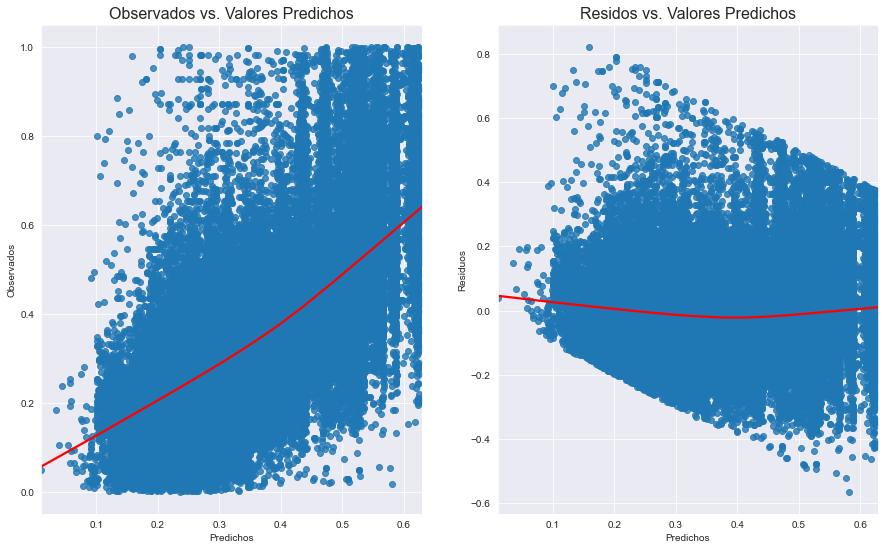

In [61]:
%matplotlib inline
#%config InlineBackend.figure_format ='retina'
import seaborn as sns 
import matplotlib.pyplot as plt
import statsmodels.stats.api as sms
sns.set_style('darkgrid')
sns.mpl.rcParams['figure.figsize'] = (15.0, 9.0)

def linearity_test(model, y):
    '''
    funcion para visualizar e identificar supuestos de linealidad sobre la regression lineal
    
    Args:
    * model - fitted OLS model from statsmodels
    * y - observed values
    '''
    fitted_vals = model.predict()
    resids = model.resid

    fig, ax = plt.subplots(1,2)
    
    sns.regplot(x=fitted_vals, y=y, lowess=True, ax=ax[0], line_kws={'color': 'red'})
    ax[0].set_title('Observados vs. Valores Predichos', fontsize=16)
    ax[0].set(xlabel='Predichos', ylabel='Observados')

    sns.regplot(x=fitted_vals, y=resids, lowess=True, ax=ax[1], line_kws={'color': 'red'})
    ax[1].set_title('Residos vs. Valores Predichos', fontsize=16)
    ax[1].set(xlabel='Predichos', ylabel='Residuos')
    
linearity_test(lin_reg, y)  

In [45]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = [variance_inflation_factor(X_constant.values, i) for i in range(X_constant.shape[1])]
pd.DataFrame({'vif': vif[1:]}, index=X.columns)

NameError: name 'X_constant' is not defined

Homocedasticidad (varianza igual) de residuos


 Breusch-Pagan test ----
                                    value
Lagrange multiplier statistic  1691.41819
p-value                           0.00000
f-value                          55.88570
f p-value                         0.00000

 Goldfeld-Quandt test ----
                value
F statistic  0.899089
p-value      1.000000

 Residuals plots ----


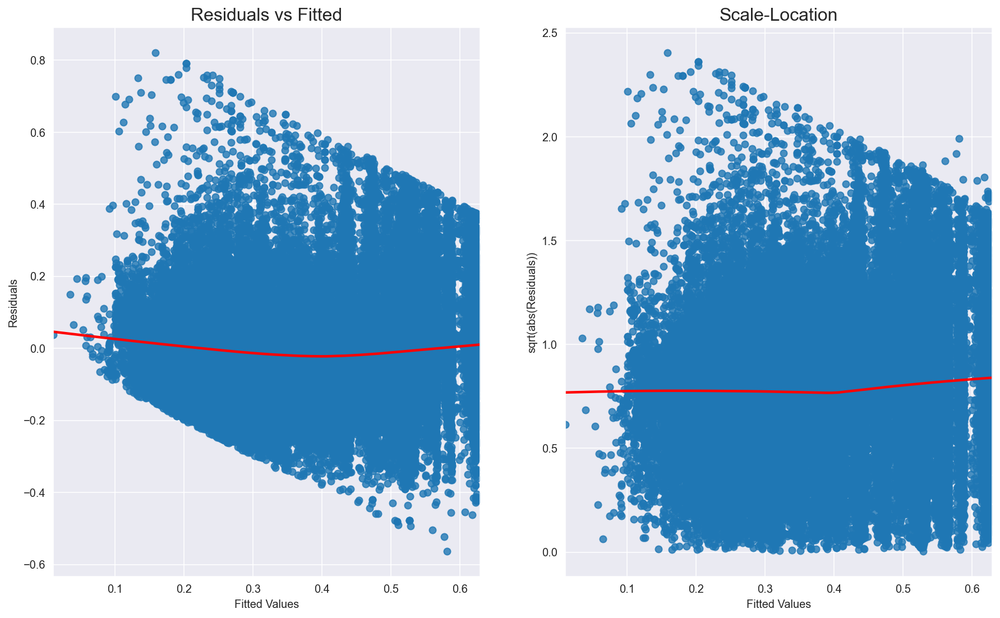

In [63]:
%matplotlib inline
%config InlineBackend.figure_format ='retina'
import seaborn as sns 
import matplotlib.pyplot as plt
import statsmodels.stats.api as sms
sns.set_style('darkgrid')
sns.mpl.rcParams['figure.figsize'] = (15.0, 9.0)

def homoscedasticity_test(model):
    '''
    Function for testing the homoscedasticity of residuals in a linear regression model.
    It plots residuals and standardized residuals vs. fitted values and runs Breusch-Pagan and Goldfeld-Quandt tests.
    
    Args:
    * model - fitted OLS model from statsmodels
    '''
    import numpy as np
    fitted_vals = model.predict()
    resids = model.resid
    resids_standardized = model.get_influence().resid_studentized_internal

    fig, ax = plt.subplots(1,2)

    sns.regplot(x=fitted_vals, y=resids, lowess=True, ax=ax[0], line_kws={'color': 'red'})
    ax[0].set_title('Residuals vs Fitted', fontsize=16)
    ax[0].set(xlabel='Fitted Values', ylabel='Residuals')

    sns.regplot(x=fitted_vals, y=np.sqrt(np.abs(resids_standardized)), lowess=True, ax=ax[1], line_kws={'color': 'red'})
    ax[1].set_title('Scale-Location', fontsize=16)
    ax[1].set(xlabel='Fitted Values', ylabel='sqrt(abs(Residuals))')

    bp_test = pd.DataFrame(sms.het_breuschpagan(resids, model.model.exog), 
                           columns=['value'],
                           index=['Lagrange multiplier statistic', 'p-value', 'f-value', 'f p-value'])

    gq_test = pd.DataFrame(sms.het_goldfeldquandt(resids, model.model.exog)[:-1],
                           columns=['value'],
                           index=['F statistic', 'p-value'])

    print('\n Breusch-Pagan test ----')
    print(bp_test)
    print('\n Goldfeld-Quandt test ----')
    print(gq_test)
    print('\n Residuals plots ----')

homoscedasticity_test(lin_reg)

La gráfica muestra que claramente este modelo no cumple el supuesto de homocedacia. Por ende para sotear este incoveniente como dijimos antes podes aplicar alguna fucion logaritmica sobre las variables predictoras o sobre la variable target.

In [3]:
import statsmodels.tsa.api as smt

acf = smt.graphics.plot_acf(lin_reg.resid, lags=40 , alpha=1.0)
#acf.show();

NameError: name 'lin_reg' is not defined

C:\Users\ThoT\anaconda3\lib\site-packages\scipy\stats\morestats.py:1681: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")
Jarque-Bera test ---- statistic: 9248.1528, p-value: 0.0
Shapiro-Wilk test ---- statistic: 0.9778, p-value: 0.0000
Kolmogorov-Smirnov test ---- statistic: 0.3804, p-value: 0.0000
Anderson-Darling test ---- statistic: 292.6561, 5% critical value: 0.7870
If the returned AD statistic is larger than the critical value, then for the 5% significance level, the null hypothesis that the data come from the Normal distribution should be rejected. 


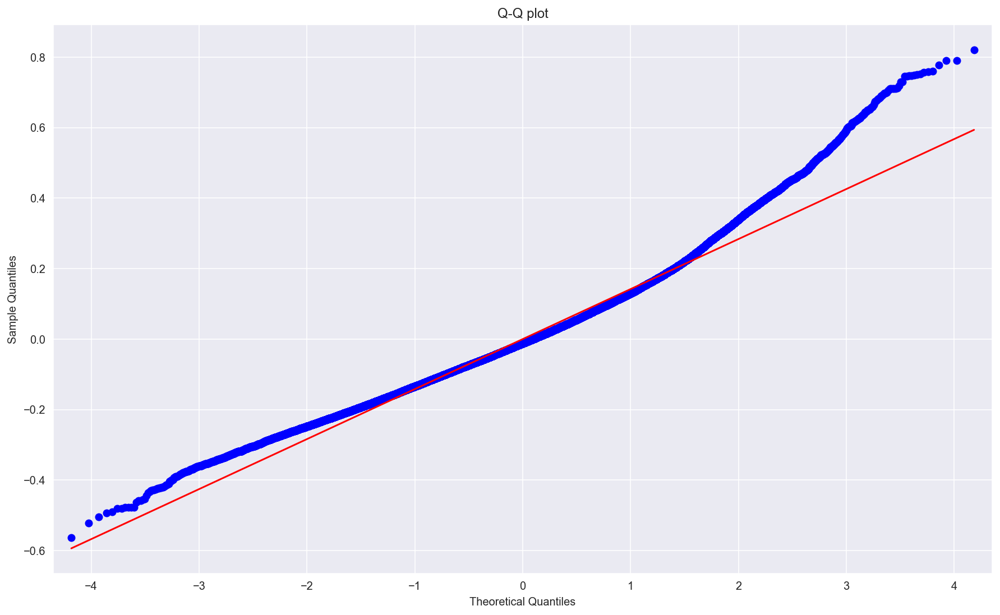

In [67]:
from scipy import stats

def normality_of_residuals_test(model):
    '''
    Function for drawing the normal QQ-plot of the residuals and running 4 statistical tests to 
    investigate the normality of residuals.
    
    Arg:
    * model - fitted OLS models from statsmodels
    '''
    sm.ProbPlot(model.resid).qqplot(line='s');
    plt.title('Q-Q plot');

    jb = stats.jarque_bera(model.resid)
    sw = stats.shapiro(model.resid)
    ad = stats.anderson(model.resid, dist='norm')
    ks = stats.kstest(model.resid, 'norm')
    
    print(f'Jarque-Bera test ---- statistic: {jb[0]:.4f}, p-value: {jb[1]}')
    print(f'Shapiro-Wilk test ---- statistic: {sw[0]:.4f}, p-value: {sw[1]:.4f}')
    print(f'Kolmogorov-Smirnov test ---- statistic: {ks.statistic:.4f}, p-value: {ks.pvalue:.4f}')
    print(f'Anderson-Darling test ---- statistic: {ad.statistic:.4f}, 5% critical value: {ad.critical_values[2]:.4f}')
    print('If the returned AD statistic is larger than the critical value, then for the 5% significance level, the null hypothesis that the data come from the Normal distribution should be rejected. ')
    
normality_of_residuals_test(lin_reg)